##**Machine Learning for Smart Health Systems: Project-4**

Instructions:

* read about human cough types - dry and wet, volunatry/ involuntary, etc. (reference: https://ieeexplore.ieee.org/document/9175986). Why cough is an important biomarker for respiratory disease? Do cough frequency vary with disease severity?

* Select a sound classification dataset containing cough/ lungs/ heart sound e.g. ESC-50 dataset https://github.com/karolpiczak/ESC-50

* make a new dataset with human cough sounds in one class and 4 other types of sounds e.g. sneezing, door knocking, raining, dog barking etc. in another class

* listen to the sounds and visualize some instances/ spectogram using the software Audacity https://www.audacityteam.org/

* label the target class audio records as cough and the other class audio records as not cough (reference: https://www.researchgate.net/publication/336011335_Efficient_Online_Cough_Detection_with_a_Minimal_Feature_Set_Using_Smartphones_for_Automated_Assessment_of_Pulmonary_Patients

* split your dataset into train and test set

* develop a cough classification model using the training set and evaluate the model performance on test set

* Retrain another model using the same dataset with Teachable Machine Platform

* Export the model and evaluate it in python on the test data

* compare your model performance with that of teachable machine

* push your code to project-4 branch of the course Github and make a pull request.

References: 

* https://ieeexplore.ieee.org/document/9175986
*https://github.com/karolpiczak/ESC-50
*https://www.audacityteam.org/
*https://www.researchgate.net/publication/336011335_Efficient_Online_Cough_Detection_with_a_Minimal_Feature_Set_Using_Smartphones_for_Automated_Assessment_of_Pulmonary_Patients
*https://www.youtube.com/watch?v=4F-cwOkMdTE
*https://github.com/krishnaik06/Audio-Classification/blob/main/Part%202-%20Audio%20Classification%20Data%20Preprocessing%20And%20Model%20Creation.ipynb


In [51]:
import pandas as pd
import numpy as np
import wave
import soundfile as sf
import os
import glob
import scipy.io
from scipy.io import wavfile
import librosa
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
from imblearn.over_sampling import SMOTE
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv1D, GlobalAveragePooling1D, MaxPooling1D, MaxPool1D
from keras.models import load_model
import random
import matplotlib.pyplot as plt
import seaborn as sns
import IPython.display
import IPython.display as ipd
import librosa.display
from tqdm import tqdm
import tensorflow as tf
from sklearn.metrics import confusion_matrix, classification_report

##Data preprocessing

The ESC-50 dataset resource: https://github.com/karolpiczak/ESC-50

For this project-4 I have picked audio files of 5classes: coughing, Thunderstorm, Vacuum cleaner, Train, Rooster. I have listen to the sounds and visualize some multiview with spectogram using the software Audacity. Attached are screenshots of the multiview of wavefiles of 5classes from Audacity software.

Coughing wavefile multiview on Audacity software

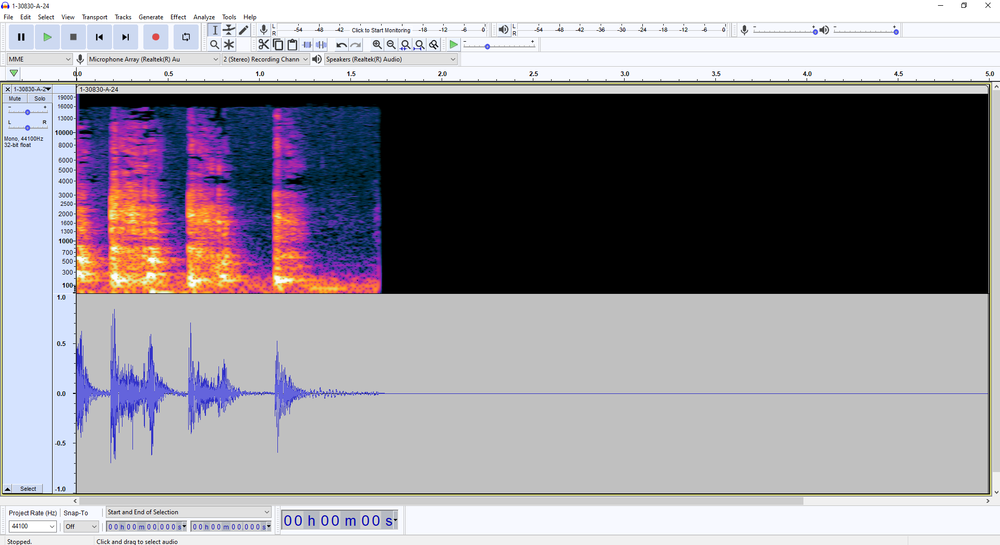

Rooster wavefile multiview on Audacity software

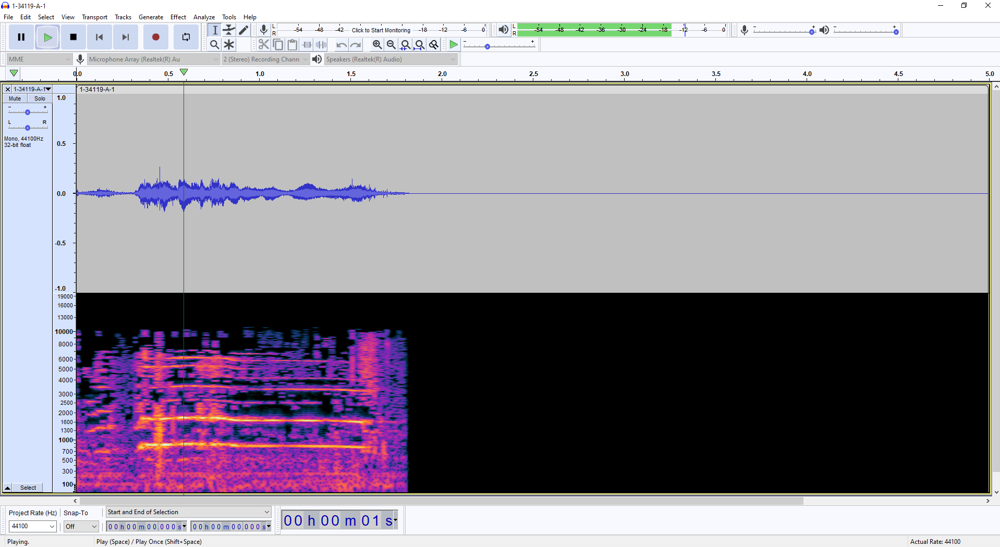

Vacuum cleaner wavefile multiview on Audacity software

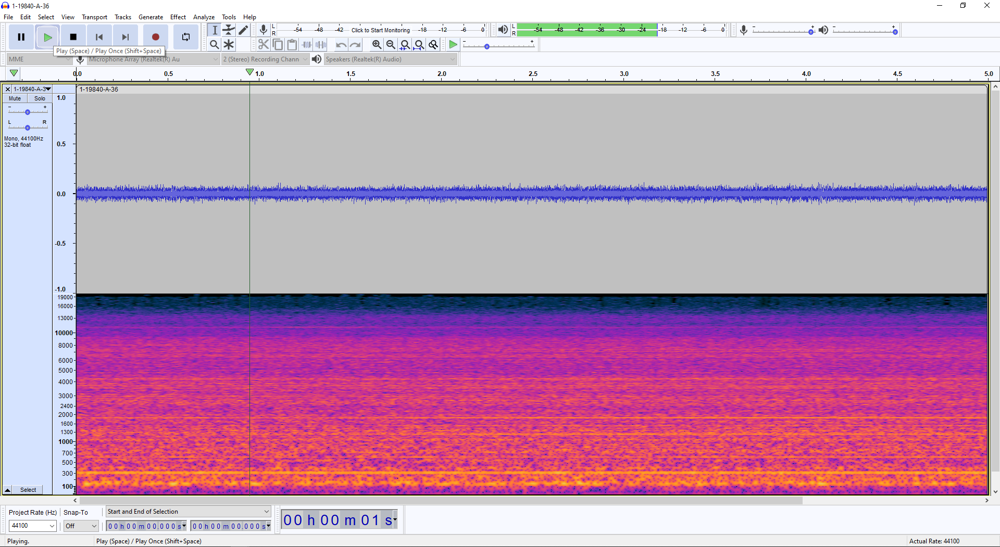

Thundestorm wavefile multiview on Audacity software

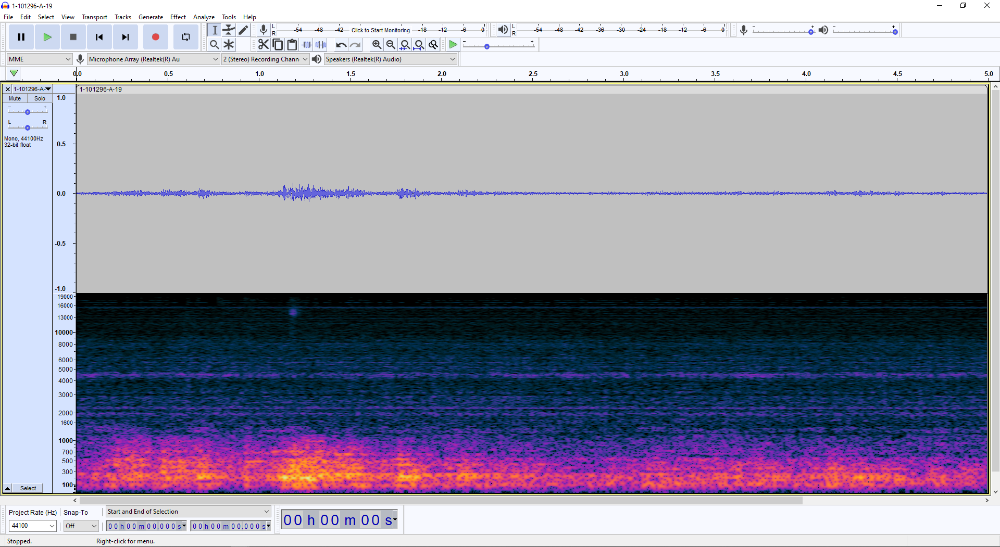

Train wavefile multiview on Audacity software

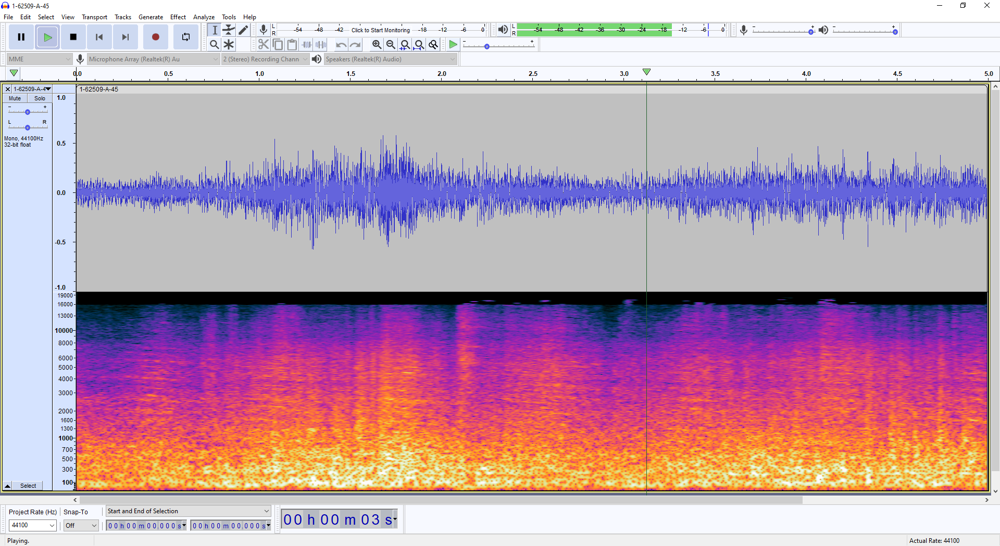

Audio Classification Data Preprocessing

In [54]:
#Let's read a sample audio using librosa
audio_file_path='/content/drive/MyDrive/audio/1-19118-A-24.wav'
librosa_audio_data,librosa_sample_rate=librosa.load(audio_file_path)

In [55]:
print(librosa_audio_data)

[0.00081044 0.00104259 0.0008793  ... 0.         0.         0.        ]


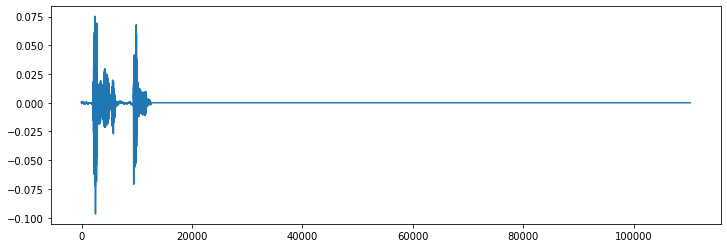

In [56]:
#Lets plot the librosa audio data
#Original audio with 1 channel 
plt.figure(figsize=(12, 4))
plt.plot(librosa_audio_data)
ipd.Audio(audio_file_path)

Comment: Here Librosa converts the signal to mono, meaning the channel will always be 1

In [57]:
#Lets read with scipy
from scipy.io import wavfile as wav
wave_sample_rate, wave_audio = wav.read(audio_file_path) 

In [58]:
wave_audio

array([37, 34, 30, ...,  0,  0,  0], dtype=int16)

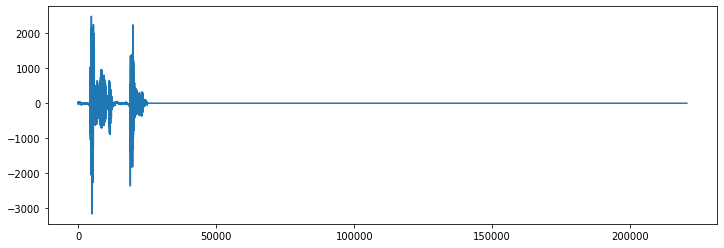

In [59]:
#Original audio with 2 channels 
plt.figure(figsize=(12, 4))
plt.plot(wave_audio)
ipd.Audio(audio_file_path)

/usr/local/lib/python3.7/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


<function matplotlib.pyplot.show>

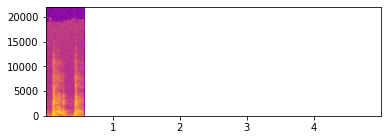

In [70]:
#Visualise spectrogram of audio/wavefile
plt.figure(figsize=(6,2))
Fs1, aud1 = wavfile.read(audio_file_path)
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(aud1, Fs=Fs1, cmap='plasma')
plt.show

Extract Features

Here we will be using Mel-Frequency Cepstral Coefficients(MFCC) from the audio samples. The MFCC summarises the frequency distribution across the window size, so it is possible to analyse both the frequency and time characteristics of the sound. These audio representations will allow us to identify features for classification.

In [60]:
mfccs = librosa.feature.mfcc(y=librosa_audio_data, sr=librosa_sample_rate, n_mfcc=40)
print(mfccs.shape)

(40, 216)


In [61]:
mfccs

array([[-6.51211304e+02, -6.61520630e+02, -6.81014526e+02, ...,
        -8.71675781e+02, -8.71675781e+02, -8.71675781e+02],
       [ 1.05693054e+02,  1.02736313e+02,  8.56614990e+01, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 3.09791870e+01,  3.13888302e+01,  2.90581913e+01, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 1.85149622e+00, -8.80061686e-02, -2.07597303e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [-5.36952496e+00, -5.84349966e+00, -4.77717876e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 3.22327900e+00,  2.11044168e+00,  2.41337061e+00, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00]], dtype=float32)

In [ ]:
#Extracting MFCC's For every audio file
audio_dataset_path='/content/drive/MyDrive/audio'
metadata_original=pd.read_csv('/content/drive/MyDrive/meta/esc50.csv')
metadata_original.head()

,filename,fold,target,category,esc10,src_file,take
0,1-100032-A-0.wav,1,0,dog,True,100032,A
1,1-100038-A-14.wav,1,14,chirping_birds,False,100038,A
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A


In [ ]:
#Creating data for categories: 'coughing','rooster','thunderstorm','vacuum_cleaner','train'
metadata = metadata_original[metadata_original['category'].isin(['coughing','rooster','thunderstorm','vacuum_cleaner','train'])]
metadata

,filename,fold,target,category,esc10,src_file,take
2,1-100210-A-36.wav,1,36,vacuum_cleaner,False,100210,A
3,1-100210-B-36.wav,1,36,vacuum_cleaner,False,100210,B
4,1-101296-A-19.wav,1,19,thunderstorm,False,101296,A
5,1-101296-B-19.wav,1,19,thunderstorm,False,101296,B
16,1-115521-A-19.wav,1,19,thunderstorm,False,115521,A
...,...,...,...,...,...,...,...
1876,5-233160-A-1.wav,5,1,rooster,True,233160,A
1888,5-234879-A-1.wav,5,1,rooster,True,234879,A
1889,5-234879-B-1.wav,5,1,rooster,True,234879,B
1949,5-251489-A-24.wav,5,24,coughing,False,251489,A


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


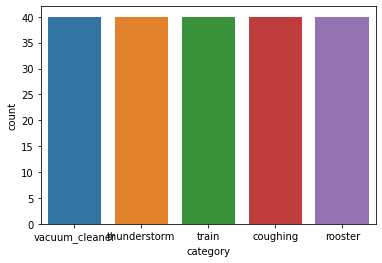

In [ ]:
#checking the data for all 5 categories: 'coughing','rooster','thunderstorm','vacuum_cleaner','train'
sns.countplot(metadata['category'])

Comment: From the plot we can infer that all 5 categories have 40 audio files each.

In [ ]:
#function for feature extraction for a file
def features_extractor(file):
    audio, sample_rate = librosa.load(file_name, res_type='kaiser_fast') 
    mfccs_features = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40)
    mfccs_scaled_features = np.mean(mfccs_features.T,axis=0)
    return mfccs_scaled_features

In [ ]:
#Now we iterate through every audio file and extract features 
#using Mel-Frequency Cepstral Coefficients
extracted_features=[]
for index_num,row in tqdm(metadata.iterrows()):
    file_name = os.path.join(os.path.abspath(audio_dataset_path)+'/',str(row["filename"]))
    final_class_labels=row["category"]
    data=features_extractor(file_name)
    extracted_features.append([data,final_class_labels])

200it [03:05,  1.08it/s]


In [ ]:
#converting extracted_features to Pandas dataframe
extracted_features_df=pd.DataFrame(extracted_features,columns=['feature','class'])
extracted_features_df

,feature,class
0,"[7.545552, 69.50337, -21.425293, 27.36884, -24...",vacuum_cleaner
1,"[8.940392, 67.5279, -19.818016, 25.955563, -21...",vacuum_cleaner
2,"[-428.37643, 132.65819, 31.139639, 42.45583, -...",thunderstorm
3,"[-402.94974, 145.47536, 31.978254, 28.712538, ...",thunderstorm
4,"[-375.54044, 178.52048, 52.144558, 2.7210095, ...",thunderstorm
...,...,...
195,"[-398.0107, 43.23773, -33.138912, -13.33536, -...",rooster
196,"[-403.38412, 34.395184, -24.902323, -6.3168263...",rooster
197,"[-369.95624, 46.1954, -18.406137, -4.60788, -9...",rooster
198,"[-539.41785, 10.603877, -5.7209377, -2.6727505...",coughing


In [ ]:
#Convert all classes other than coughing to Not coughing
extracted_features_df.loc[extracted_features_df['class'].isin(['rooster','thunderstorm','vacuum_cleaner','train']),'class'] = 'Not Coughing'
extracted_features_df

,feature,class
0,"[7.545552, 69.50337, -21.425293, 27.36884, -24...",Not Coughing
1,"[8.940392, 67.5279, -19.818016, 25.955563, -21...",Not Coughing
2,"[-428.37643, 132.65819, 31.139639, 42.45583, -...",Not Coughing
3,"[-402.94974, 145.47536, 31.978254, 28.712538, ...",Not Coughing
4,"[-375.54044, 178.52048, 52.144558, 2.7210095, ...",Not Coughing
...,...,...
195,"[-398.0107, 43.23773, -33.138912, -13.33536, -...",Not Coughing
196,"[-403.38412, 34.395184, -24.902323, -6.3168263...",Not Coughing
197,"[-369.95624, 46.1954, -18.406137, -4.60788, -9...",Not Coughing
198,"[-539.41785, 10.603877, -5.7209377, -2.6727505...",coughing


In [ ]:
#Convert labels to numeric coughing as 1 and not coughing as 0 and drop the class feature
extracted_features_df.loc[extracted_features_df['class']=='coughing','label'] = 1
extracted_features_df.loc[extracted_features_df['class']=='Not Coughing','label'] = 0
extracted_features_df.drop(columns='class', axis=1, inplace=True )


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


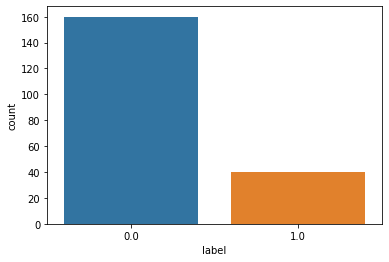

In [ ]:
#Plot the dataset class to check data balance
sns.countplot(extracted_features_df['label'])

Comment: Countplot shows that data is imbalanced. So lets try upsampling.

##Data balancing 


Here I am upsampling the coughing class to equalize with the notcoughing class

In [ ]:
#print the dataset after droping class feature
extracted_features_df

,feature,label
0,"[7.545552, 69.50337, -21.425293, 27.36884, -24...",0.0
1,"[8.940392, 67.5279, -19.818016, 25.955563, -21...",0.0
2,"[-428.37643, 132.65819, 31.139639, 42.45583, -...",0.0
3,"[-402.94974, 145.47536, 31.978254, 28.712538, ...",0.0
4,"[-375.54044, 178.52048, 52.144558, 2.7210095, ...",0.0
...,...,...
195,"[-398.0107, 43.23773, -33.138912, -13.33536, -...",0.0
196,"[-403.38412, 34.395184, -24.902323, -6.3168263...",0.0
197,"[-369.95624, 46.1954, -18.406137, -4.60788, -9...",0.0
198,"[-539.41785, 10.603877, -5.7209377, -2.6727505...",1.0


In [ ]:
#Data balancing with upsampling for coughing
Coughing = extracted_features_df.loc[extracted_features_df['label'] == 1.0]
Not_coughing = extracted_features_df.loc[extracted_features_df['label'] == 0.0]


In [ ]:
#print coughing to check data
Coughing

,feature,label
6,"[-539.0872, 17.49088, -12.3629465, 3.7536557, ...",1.0
7,"[-824.1222, 15.432055, -1.2917752, 4.087993, -...",1.0
18,"[-475.63715, 42.186386, 0.73853, 8.700089, 8.2...",1.0
26,"[-450.54584, 87.849075, 3.986298, 3.745215, -1...",1.0
27,"[-495.3561, 51.93067, -8.814651, 22.883694, 5....",1.0
28,"[-511.38504, 56.249634, 5.3670936, 2.4224453, ...",1.0
31,"[-218.88301, 52.987934, -16.699333, 1.6800611,...",1.0
34,"[-344.78415, 60.787594, -15.995295, 13.554341,...",1.0
45,"[-306.4123, 85.13166, 21.697008, 12.351476, 11...",1.0
52,"[-351.8653, 70.79985, -17.100191, -2.429431, -...",1.0


In [ ]:
#print not coughing to check data
Not_coughing

,feature,label
0,"[7.545552, 69.50337, -21.425293, 27.36884, -24...",0.0
1,"[8.940392, 67.5279, -19.818016, 25.955563, -21...",0.0
2,"[-428.37643, 132.65819, 31.139639, 42.45583, -...",0.0
3,"[-402.94974, 145.47536, 31.978254, 28.712538, ...",0.0
4,"[-375.54044, 178.52048, 52.144558, 2.7210095, ...",0.0
...,...,...
194,"[-240.59589, 122.81578, -6.971493, -4.087081, ...",0.0
195,"[-398.0107, 43.23773, -33.138912, -13.33536, -...",0.0
196,"[-403.38412, 34.395184, -24.902323, -6.3168263...",0.0
197,"[-369.95624, 46.1954, -18.406137, -4.60788, -9...",0.0


In [ ]:
#upsampling coughing 
upsampled_coughing = resample(Coughing, replace=True, n_samples=len(Not_coughing),random_state=21)

In [ ]:
#combining not_coughing and upsampled_coughing
upsampled = pd.concat([Not_coughing,upsampled_coughing])

In [ ]:
#counting values for both coughing and notcoughing
upsampled['label'].value_counts()

1.0    160
0.0    160
Name: label, dtype: int64

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


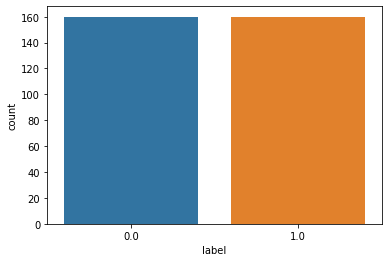

In [ ]:
#Plot the dataset class to check data balance
sns.countplot(upsampled['label'])

Now the data balanced using upsampling or over sampling

##Splitting the dataset

In [ ]:
#split the dataset into X and y
X = np.array(upsampled['feature'].tolist())
y = np.array(upsampled['label'].tolist())
y = np.array(pd.get_dummies(y))

In [ ]:
print(X.shape)
print(y.shape)

(320, 40)
(320, 2)


In [ ]:
#Splitting data into test and train sets
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2 , random_state=21)

In [ ]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(256, 40)
(64, 40)
(256, 2)
(64, 2)


##Data Modeling

**Basic Sequential CNN Model : with 3 convolutional layer and 3 dense layers**

In [ ]:
#Reshape train and test data 
X_train = np.array(X_train).reshape(X_train.shape[0], X_train.shape[1], 1)
X_test = np.array(X_test).reshape(X_test.shape[0], X_test.shape[1], 1)
print("X Train shape: ", X_train.shape)
print("X Test shape: ", X_test.shape)

X Train shape:  (256, 40, 1)
X Test shape:  (64, 40, 1)


In [ ]:
model3 = tf.keras.models.Sequential()
#First CNN convolution layer  with 32 filters
model3.add(Conv1D(filters=32, kernel_size=(3,), padding='same', activation=tf.keras.layers.LeakyReLU(alpha=0.001), input_shape = (X_train.shape[1],1)))
#Second CNN convolution layer  with 64 filters
model3.add(Conv1D(filters=64, kernel_size=(3,), padding='same', activation=tf.keras.layers.LeakyReLU(alpha=0.001)))
#Third CNN convolution layer with 128 filters
model3.add(Conv1D(filters=128, kernel_size=(3,), padding='same', activation=tf.keras.layers.LeakyReLU(alpha=0.001)))
#Fourth CNN layer with Max pooling
model3.add(MaxPool1D(pool_size=(3,), strides=2, padding='same'))
# Drop out layer
model3.add(Dropout(0.5))
#Flatten the output
model3.add(Flatten())
#Add a dense layer with 256 neurons
model3.add(Dense(units = 256, activation=tf.keras.layers.LeakyReLU(alpha=0.001)))
#Add a dense layer with 512 neurons
model3.add(Dense(units = 512, activation=tf.keras.layers.LeakyReLU(alpha=0.001)))
#Softmax as last layer with 2 outputs
model3.add(Dense(units = 2, activation='softmax'))

In [ ]:
model3.compile(loss='categorical_crossentropy',optimizer='adam',metrics=['accuracy'])
acc = model3.evaluate(X_train, y_train)
print("Loss:", acc[0], " Accuracy:", acc[1])

8/8 [==============================] - 1s 7ms/step - loss: 1.0944 - accuracy: 0.5000
Loss: 1.0944007635116577  Accuracy: 0.5


In [ ]:
model3_history = model3.fit(X_train, y_train, epochs=50, batch_size = 100, validation_split=0.20)

Epoch 1/50
3/3 [==============================] - 1s 232ms/step - loss: 8.1890 - accuracy: 0.4804 - val_loss: 0.2183 - val_accuracy: 0.9231
Epoch 2/50
3/3 [==============================] - 0s 45ms/step - loss: 1.3773 - accuracy: 0.7010 - val_loss: 0.5522 - val_accuracy: 0.8846
Epoch 3/50
3/3 [==============================] - 0s 43ms/step - loss: 1.0782 - accuracy: 0.7892 - val_loss: 1.6382 - val_accuracy: 0.4231
Epoch 4/50
3/3 [==============================] - 0s 47ms/step - loss: 1.0917 - accuracy: 0.6667 - val_loss: 0.4084 - val_accuracy: 0.7500
Epoch 5/50
3/3 [==============================] - 0s 52ms/step - loss: 0.4502 - accuracy: 0.7892 - val_loss: 0.2121 - val_accuracy: 0.9038
Epoch 6/50
3/3 [==============================] - 0s 46ms/step - loss: 0.5005 - accuracy: 0.8088 - val_loss: 0.1898 - val_accuracy: 0.9231
Epoch 7/50
3/3 [==============================] - 0s 44ms/step - loss: 0.4546 - accuracy: 0.8529 - val_loss: 0.1949 - val_accuracy: 0.9038
Epoch 8/50
3/3 [==========

In [ ]:
#Print confusion matrix and classification report
y_pred = model3.predict(X_test)
y_test_class = np.argmax(y_test, axis=1)
y_pred_class = np.argmax(y_pred, axis=1)
cm_cnn=confusion_matrix(y_test_class, y_pred_class)
print(cm_cnn)
print(classification_report(y_test_class, y_pred_class))

[[29  3]
 [ 0 32]]
              precision    recall  f1-score   support

           0       1.00      0.91      0.95        32
           1       0.91      1.00      0.96        32

    accuracy                           0.95        64
   macro avg       0.96      0.95      0.95        64
weighted avg       0.96      0.95      0.95        64



Train: 0.996, Test: 0.953


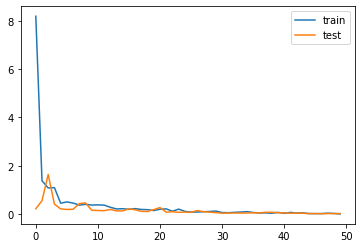

In [ ]:
# evaluate the model
_, train_acc = model3.evaluate(X_train, y_train, verbose=0)
_, test_acc = model3.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
# plot training history
plt.plot(model3_history.history['loss'], label='train')
plt.plot(model3_history.history['val_loss'], label='test')
plt.legend()
plt.show()

Train: 0.996, Test: 0.953


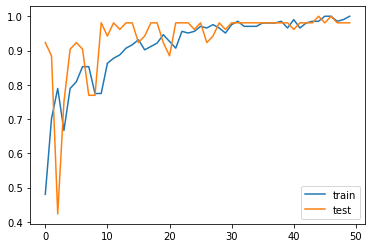

In [ ]:
_, train_acc = model3.evaluate(X_train, y_train, verbose=0)
_, test_acc = model3.evaluate(X_test, y_test, verbose=0)
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))
plt.plot(model3_history.history['accuracy'], label='train')
plt.plot(model3_history.history['val_accuracy'], label='test')
plt.legend()
plt.show()

Comment: Accuracy for CNN model is 95%.

**ANN**

In [ ]:
import tensorflow as tf
print(tf.__version__)

2.7.0


In [ ]:
#No of classes
num_labels=y.shape[1]

In [ ]:
model=Sequential()
#first layer
model.add(Dense(100,input_shape=(40,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))
#second layer
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))
#third layer
model.add(Dense(100))
model.add(Activation('relu'))
model.add(Dropout(0.5))

#final layer
model.add(Dense(num_labels))
model.add(Activation('softmax'))

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 100)               4100      
                                                                 
 activation (Activation)     (None, 100)               0         
                                                                 
 dropout_1 (Dropout)         (None, 100)               0         
                                                                 
 dense_4 (Dense)             (None, 200)               20200     
                                                                 
 activation_1 (Activation)   (None, 200)               0         
                                                                 
 dropout_2 (Dropout)         (None, 200)               0         
                                                                 
 dense_5 (Dense)             (None, 100)              

In [ ]:
model.compile(loss='categorical_crossentropy',metrics=['accuracy'],optimizer='adam')

In [ ]:
#Training ANN model
from tensorflow.keras.callbacks import ModelCheckpoint
from datetime import datetime 

num_epochs = 100
num_batch_size = 32

checkpointer = ModelCheckpoint(filepath='saved_models/audio_classification.hdf5', 
                               verbose=1, save_best_only=True)
start = datetime.now()

model.fit(X_train, y_train, batch_size=num_batch_size, epochs=num_epochs, validation_data=(X_test, y_test), callbacks=[checkpointer], verbose=1)


duration = datetime.now() - start
print("Training completed in time: ", duration)

Epoch 1/100
1/8 [==>...........................] - ETA: 3s - loss: 21.5208 - accuracy: 0.4688
Epoch 00001: val_loss improved from inf to 5.05758, saving model to saved_models/audio_classification.hdf5
8/8 [==============================] - 1s 29ms/step - loss: 20.1816 - accuracy: 0.5586 - val_loss: 5.0576 - val_accuracy: 0.7031
Epoch 2/100
1/8 [==>...........................] - ETA: 0s - loss: 11.1053 - accuracy: 0.5938
Epoch 00002: val_loss did not improve from 5.05758
8/8 [==============================] - 0s 5ms/step - loss: 16.0213 - accuracy: 0.5586 - val_loss: 6.3282 - val_accuracy: 0.6875
Epoch 3/100
1/8 [==>...........................] - ETA: 0s - loss: 10.4936 - accuracy: 0.6250
Epoch 00003: val_loss did not improve from 5.05758
8/8 [==============================] - 0s 5ms/step - loss: 11.8235 - accuracy: 0.6055 - val_loss: 6.5064 - val_accuracy: 0.6875
Epoch 4/100
1/8 [==>...........................] - ETA: 0s - loss: 14.8953 - accuracy: 0.5312
Epoch 00004: val_loss did not 

In [ ]:
test_accuracy=model.evaluate(X_test,y_test,verbose=0)
print(test_accuracy[1])

0.765625


Comment: Accuracy for ANN model is 76.56%.

##Creating folders with dataset for classes: 'coughing','rooster','thunderstorm','vacuum_cleaner','train' inorder to fetch into Teachable machine.

In [62]:
# #Creating a folder in the google drive of audio files for coughing
# import shutil, os
# audio = []
# audio_path = '/content/drive/MyDrive/audio'
# coughing_path = '/content/drive/MyDrive/coughing'
# files = os.listdir(audio_path)

# for f1 in glob.glob(os.path.join(audio_path, '*-24.wav')):
#   samplerate, data = wavfile.read(f1)
#   audio.append(f1)

# files = audio
# for f in files:
#   shutil.move(f, '/content/drive/MyDrive/coughing')

In [63]:
# #Creating a folder in the google drive of audio files for thunderstorm
# import shutil, os
# audio = []
# audio_path = '/content/drive/MyDrive/audio'
# thunderstorm_path = '/content/drive/MyDrive/thunderstorm'
# files = os.listdir(audio_path)

# for f1 in glob.glob(os.path.join(audio_path, '*-19.wav')):
#   samplerate, data = wavfile.read(f1)
#   audio.append(f1)

# files = audio
# for f in files:
#   shutil.move(f, '/content/drive/MyDrive/thunderstorm')

In [64]:
# #Creating a folder in the google drive of audio files for vacuum cleaner
# import shutil, os
# audio = []
# audio_path = '/content/drive/MyDrive/audio'
# vacuum_cleaner_path = '/content/drive/MyDrive/vacuum_cleaner'
# files = os.listdir(audio_path)

# for f1 in glob.glob(os.path.join(audio_path, '*-36.wav')):
#   samplerate, data = wavfile.read(f1)
#   audio.append(f1)

# files = audio
# for f in files:
#   shutil.move(f, '/content/drive/MyDrive/vacuum_cleaner')

In [65]:
# #Creating a folder in the google drive of audio files for train
# import shutil, os
# audio = []
# audio_path = '/content/drive/MyDrive/audio'
# train_path = '/content/drive/MyDrive/train'
# files = os.listdir(audio_path)

# for f1 in glob.glob(os.path.join(audio_path, '*-45.wav')):
#   samplerate, data = wavfile.read(f1)
#   audio.append(f1)

# files = audio
# for f in files:
#   shutil.move(f, '/content/drive/MyDrive/train')

In [66]:
# #Creating a folder in the google drive of audio files for rooster
# import shutil, os
# audio = []
# audio_path = '/content/drive/MyDrive/audio'
# rooster_path = '/content/drive/MyDrive/rooster'
# files = os.listdir(audio_path)

# for f1 in glob.glob(os.path.join(audio_path, '*-1.wav')):
#   samplerate, data = wavfile.read(f1)
#   audio.append(f1)

# files = audio
# for f in files:
#   shutil.move(f, '/content/drive/MyDrive/rooster')

I have commented the above codes after creating folders into my drive and downloaded those folders into my system. The downloaded folders are going to be used for creating spectrograms to fetch teachable machine

##Creating spectrograms for coughing class and no coughing class

The following sprectrograms of coughing class and no coughing class are going to fetch into Teachable machine.

**Coughing class spectrograms:**

In [73]:
#extracting list of coughing wavefiles
coughing_wavefiles = []
coughing_path = '/content/drive/MyDrive/coughing'
files = os.listdir(coughing_path)

for f1 in glob.glob(os.path.join(coughing_path, '*-24.wav')):
  samplerate, data = wavfile.read(f1)
  coughing_wavefiles.append(f1)

In [74]:
coughing_wavefiles

['/content/drive/MyDrive/coughing/1-19111-A-24.wav',
 '/content/drive/MyDrive/coughing/1-19118-A-24.wav',
 '/content/drive/MyDrive/coughing/1-30830-A-24.wav',
 '/content/drive/MyDrive/coughing/1-52323-A-24.wav',
 '/content/drive/MyDrive/coughing/1-53663-A-24.wav',
 '/content/drive/MyDrive/coughing/1-52266-A-24.wav',
 '/content/drive/MyDrive/coughing/1-58792-A-24.wav',
 '/content/drive/MyDrive/coughing/1-63679-A-24.wav',
 '/content/drive/MyDrive/coughing/2-108017-A-24.wav',
 '/content/drive/MyDrive/coughing/2-123896-A-24.wav',
 '/content/drive/MyDrive/coughing/2-87795-A-24.wav',
 '/content/drive/MyDrive/coughing/2-87412-A-24.wav',
 '/content/drive/MyDrive/coughing/2-87799-A-24.wav',
 '/content/drive/MyDrive/coughing/2-87794-A-24.wav',
 '/content/drive/MyDrive/coughing/2-85292-A-24.wav',
 '/content/drive/MyDrive/coughing/2-98676-A-24.wav',
 '/content/drive/MyDrive/coughing/3-125418-A-24.wav',
 '/content/drive/MyDrive/coughing/3-132601-A-24.wav',
 '/content/drive/MyDrive/coughing/3-142604

In [75]:
#function for visualising wavefiles
def wav_plots(file_name):
  fig, ax = plt.subplots(1, figsize=(10,10))
  data,sample_rate=librosa.load(file_name,sr=None)
  plot=librosa.display.waveplot(data,sr=sample_rate)
  return(plot)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


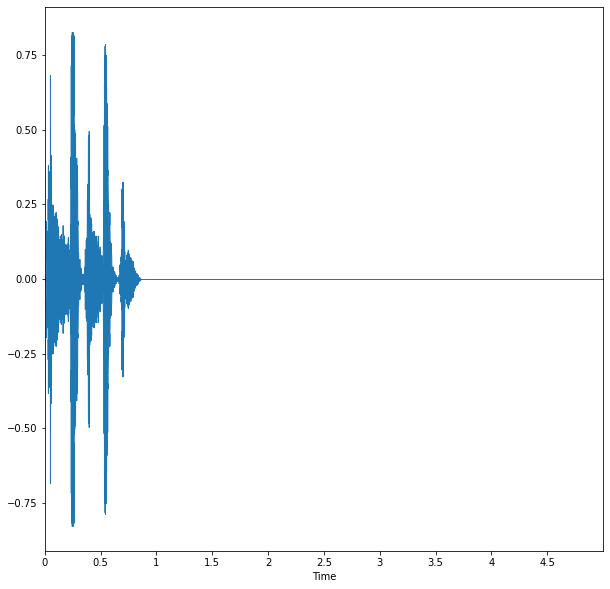

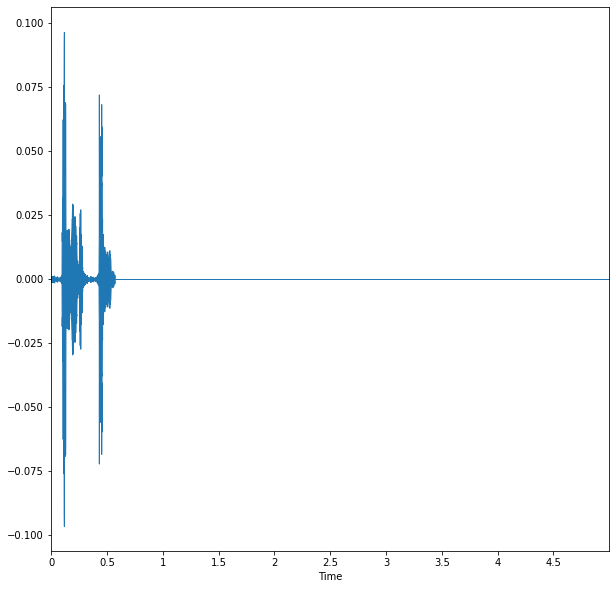

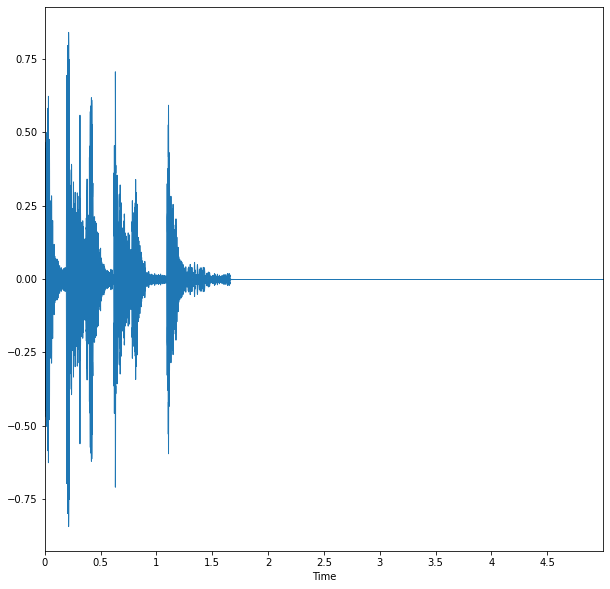

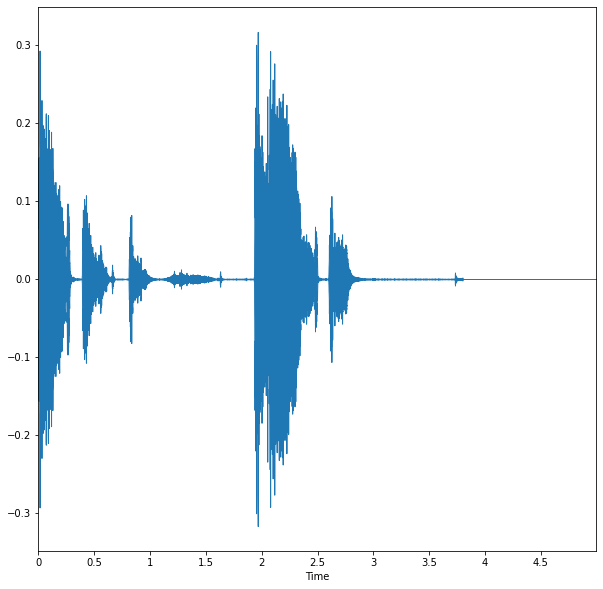

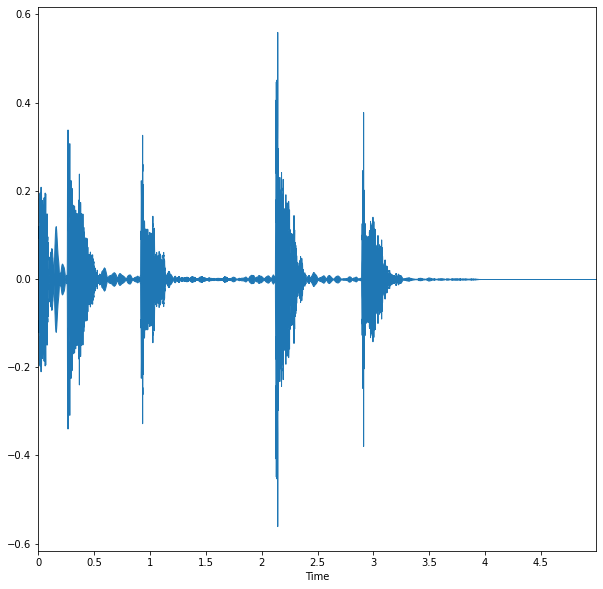

...

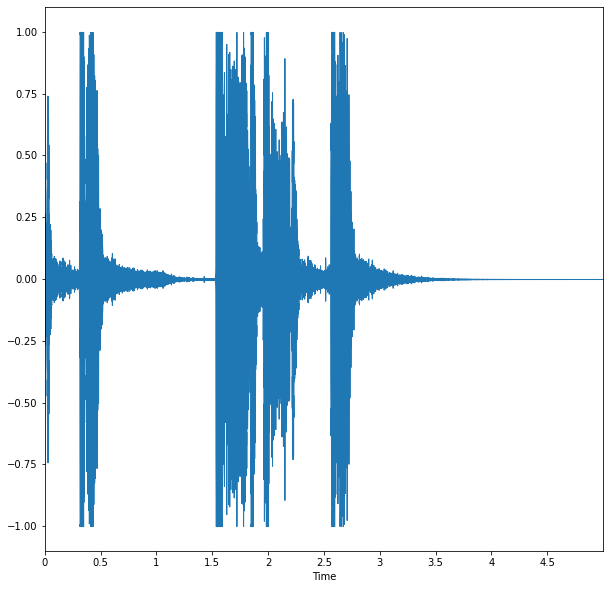

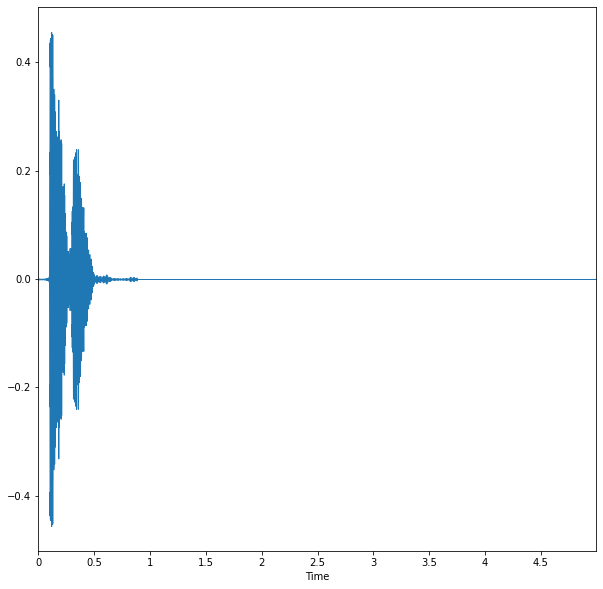

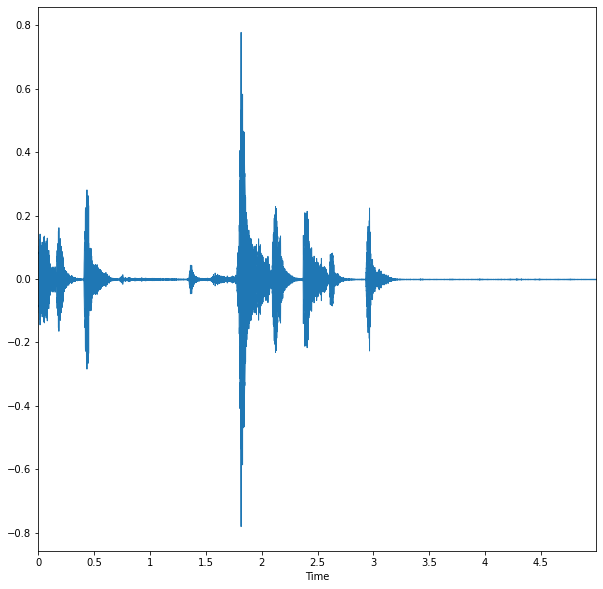

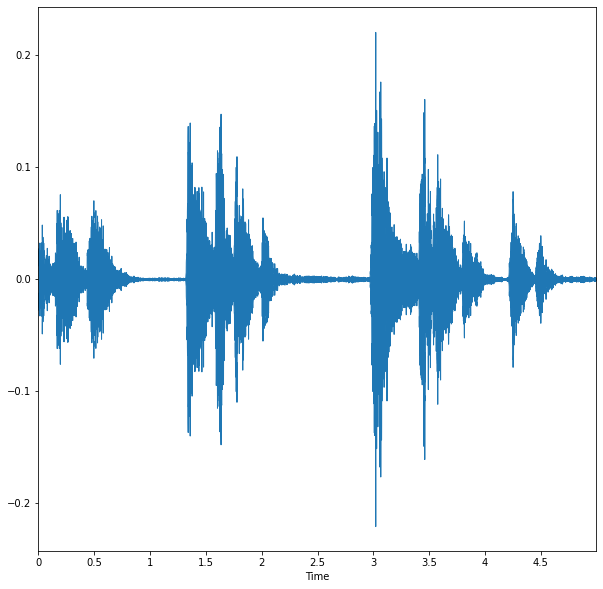

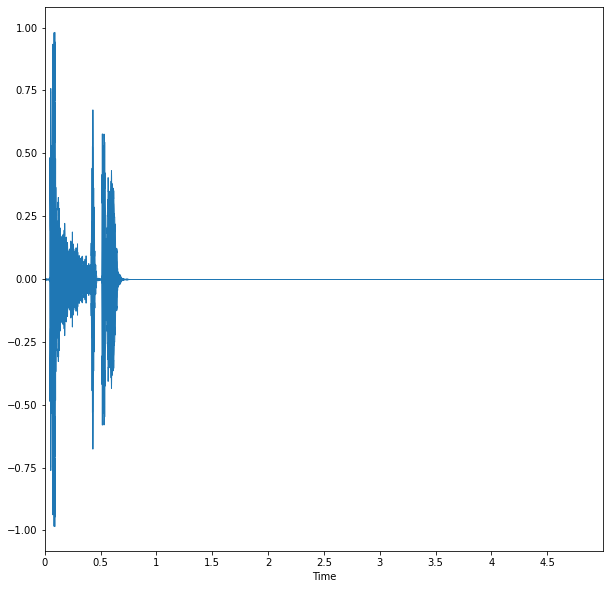

In [76]:
import numpy as np
from tqdm import tqdm  #  Instantly make your loops show a smart progress meter
# Now we iterate through every audio file in the metadata and extract features for each audio file
for row in (coughing_wavefiles):
    file_name = os.path.join(os.path.abspath(row))
    viz=wav_plots(file_name)

In [77]:
#function to convert audio to spectrogram of a wavfile
def convert_audio_to_spectogram_log(filename):
    x, sr = librosa.load(filename, sr=44100)
    X = librosa.stft(x)
    Xdb = librosa.amplitude_to_db(abs(X))
    fig=plt.figure(figsize=(14, 5))
    librosa.display.specshow(Xdb, sr = sr, x_axis = 'time', y_axis = 'log')
    plt.title(filename)
    plt.colorbar() 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


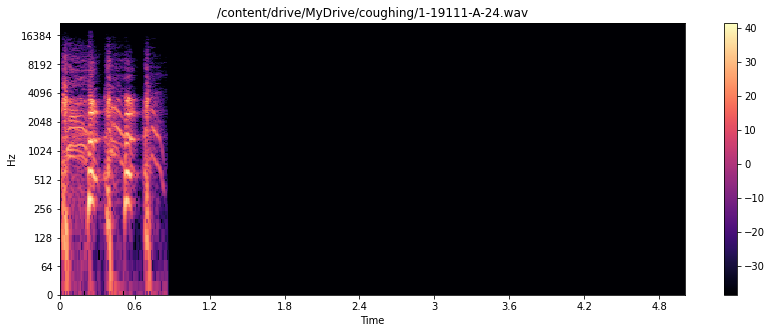

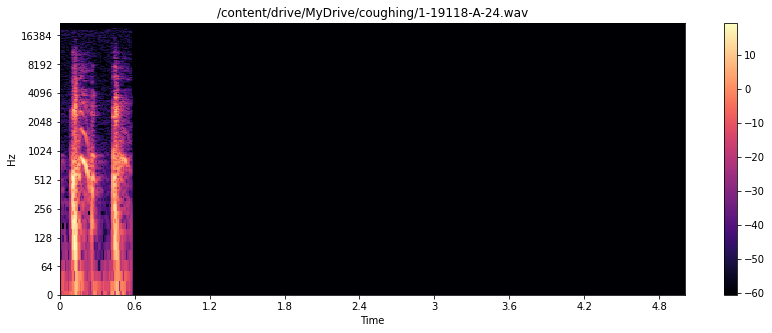

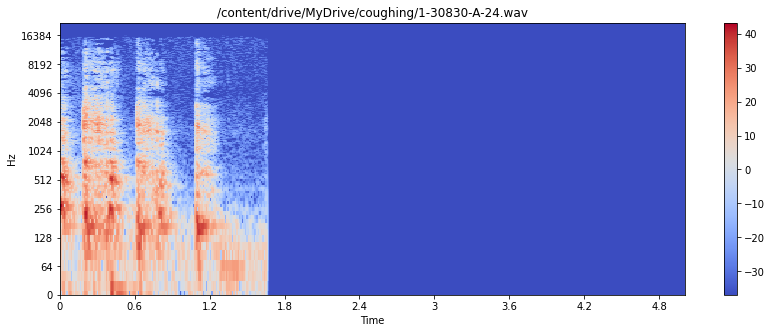

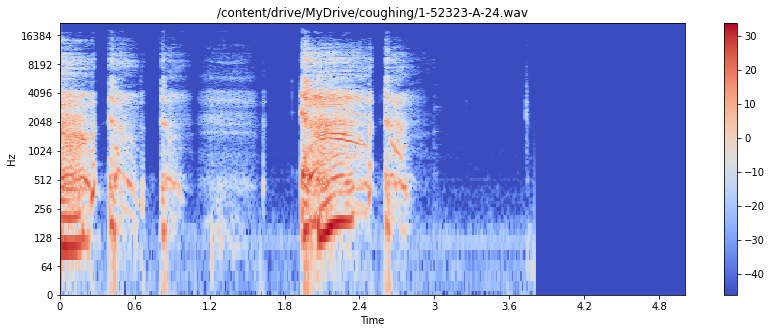

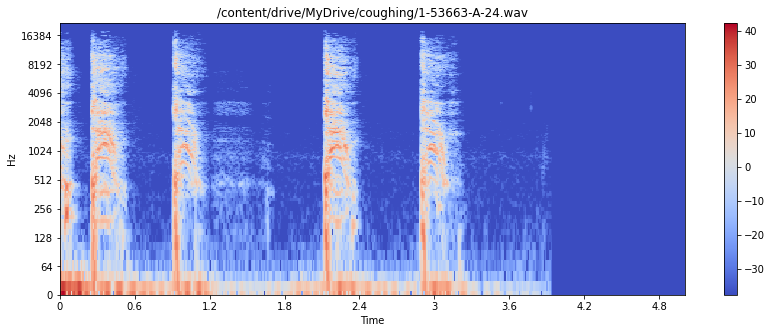

...

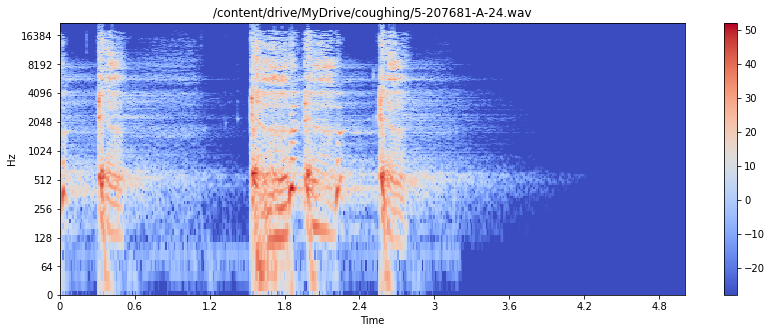

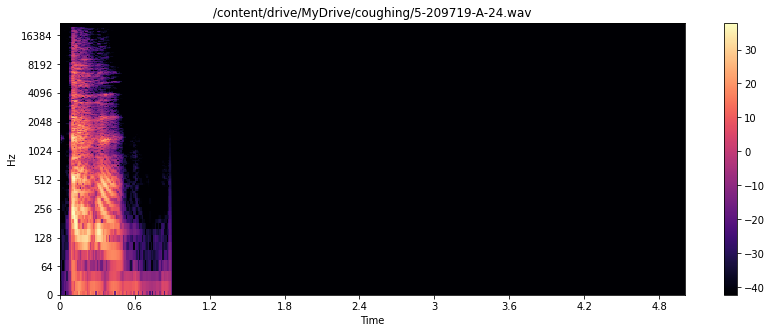

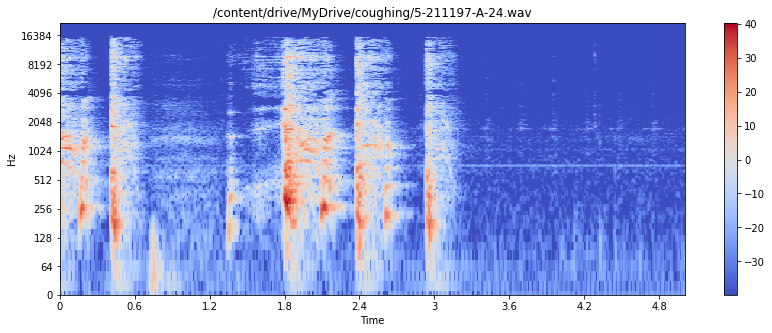

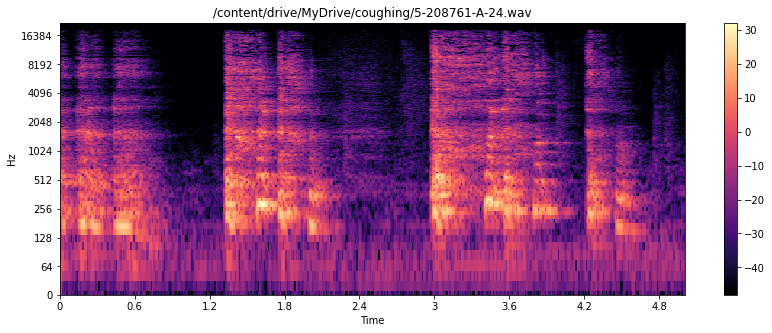

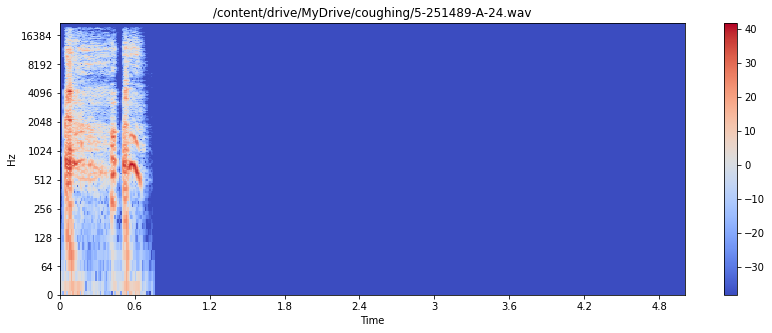

In [78]:
for row in (coughing_wavefiles):
    file_name1 = os.path.join(os.path.abspath(row))
    viz=convert_audio_to_spectogram_log(file_name1)

**No Coughing class spectrograms:**

In [86]:
#extracting list of coughing wavefiles
No_coughing_wavefiles = []
No_coughing_path = '/content/drive/MyDrive/No_coughing_wavefiles'
files = os.listdir(No_coughing_path)

for f1 in glob.glob(os.path.join(No_coughing_path, '*-36.wav')):
  samplerate, data = wavfile.read(f1)
  No_coughing_wavefiles.append(f1)

for f1 in glob.glob(os.path.join(No_coughing_path,  '*-19.wav')):
  samplerate, data = wavfile.read(f1)
  No_coughing_wavefiles.append(f1)

for f1 in glob.glob(os.path.join(No_coughing_path,  '*-1.wav')):
  samplerate, data = wavfile.read(f1)
  No_coughing_wavefiles.append(f1)

for f1 in glob.glob(os.path.join(No_coughing_path,  '*-45.wav')):
  samplerate, data = wavfile.read(f1)
  No_coughing_wavefiles.append(f1)

In [87]:
No_coughing_wavefiles

['/content/drive/MyDrive/No_coughing_wavefiles/3-159346-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/2-141681-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/1-19872-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/2-122820-B-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/1-19840-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/5-182012-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/5-182010-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/4-172733-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/4-172732-A-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/3-152020-C-36.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/4-161519-A-19.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/2-39443-A-19.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/3-103051-A-19.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/2-39441-A-19.wav',
 '/content/drive/MyDrive/No_coughing_wavefiles/3-103050-A-19.wav',

In [88]:
#function for visualising wavefiles
def wav_plots(file_name):
  fig, ax = plt.subplots(1, figsize=(10,10))
  data,sample_rate=librosa.load(file_name,sr=None)
  plot=librosa.display.waveplot(data,sr=sample_rate)
  return(plot)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


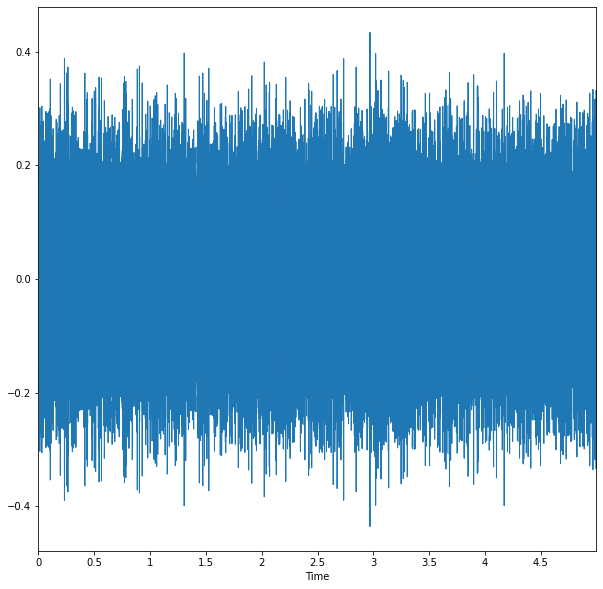

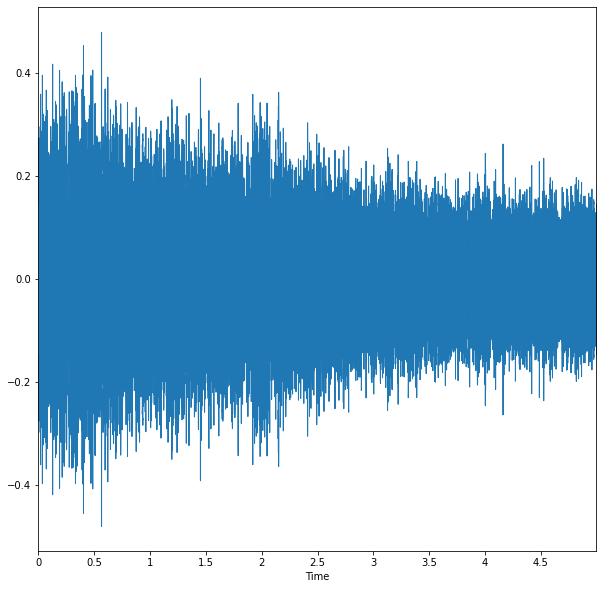

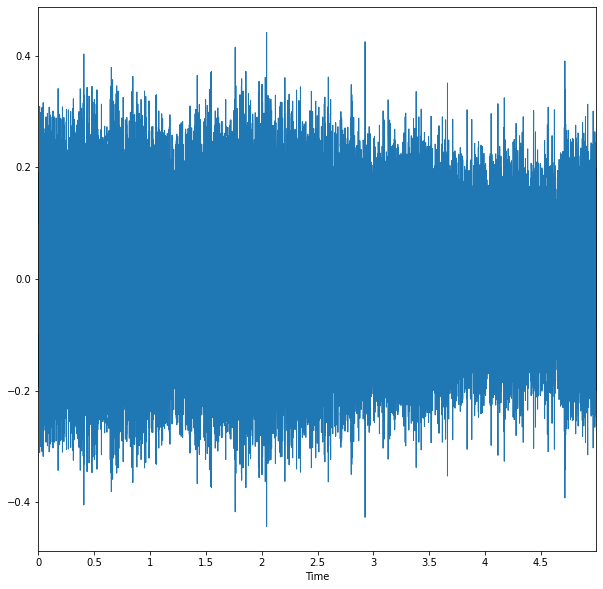

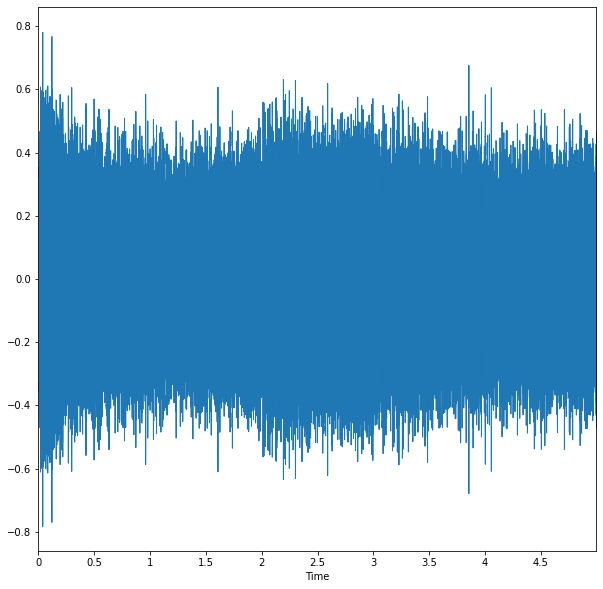

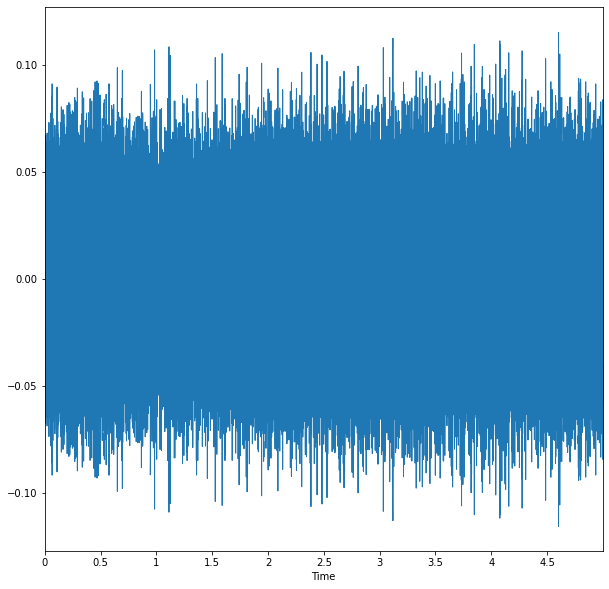

...

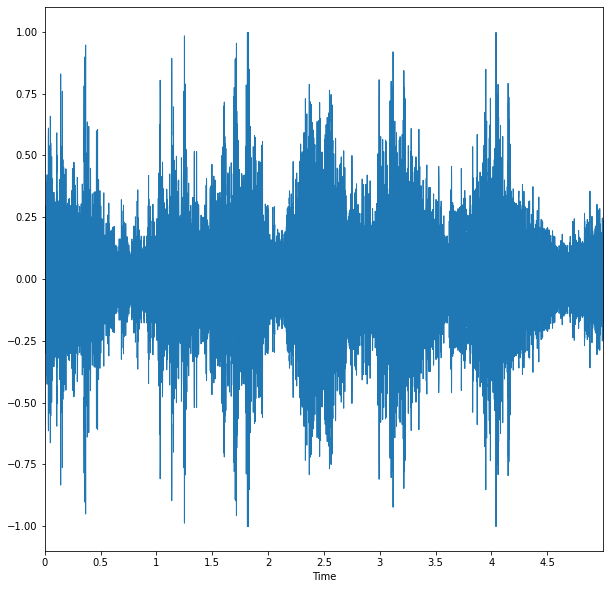

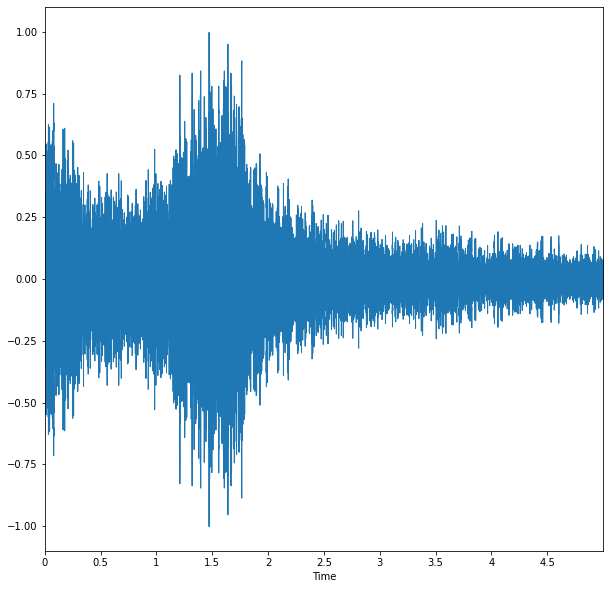

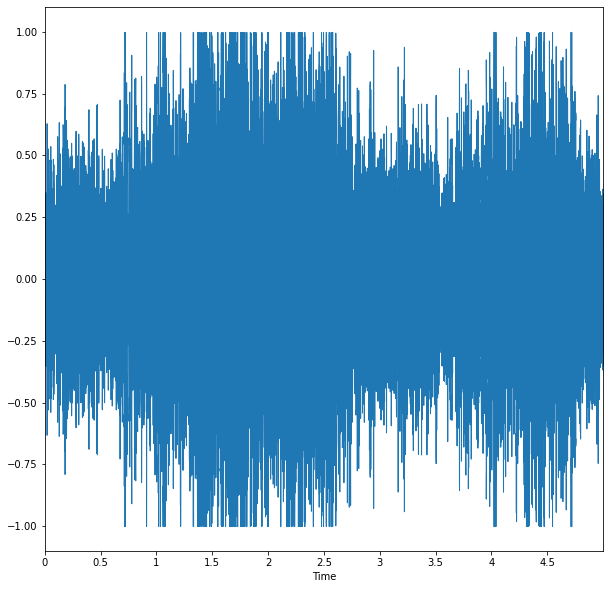

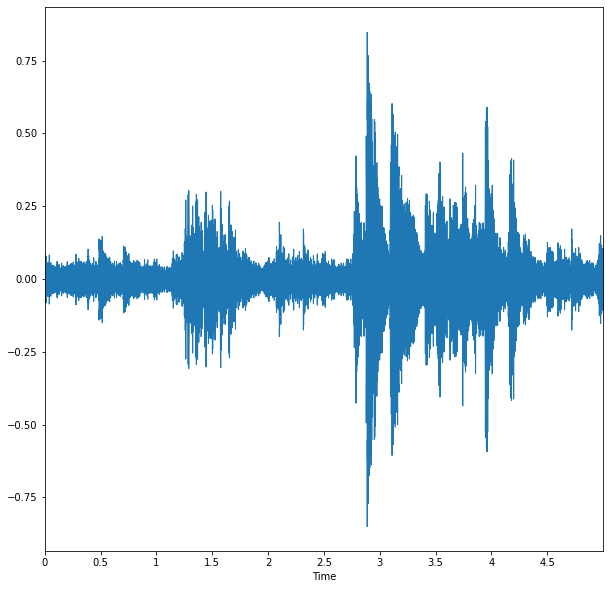

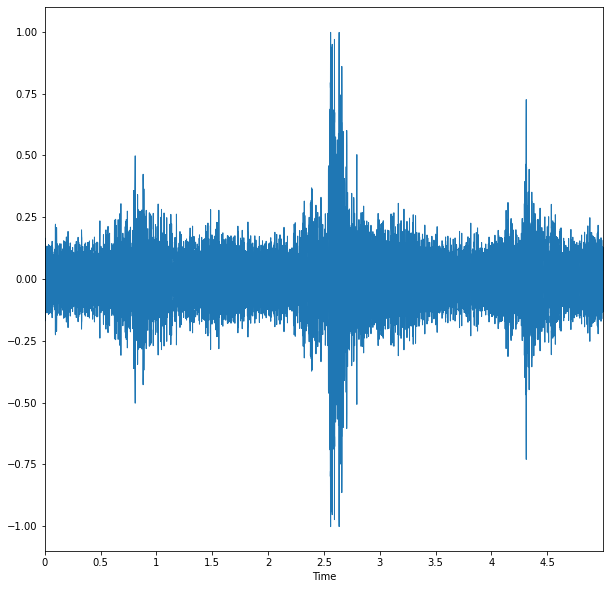

In [91]:
import numpy as np
from tqdm import tqdm  #  Instantly make your loops show a smart progress meter
# Now we iterate through every audio file in the metadata and extract features for each audio file
for row in (No_coughing_wavefiles):
    file_name = os.path.join(os.path.abspath(row))
    viz=wav_plots(file_name)

In [92]:
#function to convert audio to spectrogram of a wavfile
def convert_audio_to_spectogram_log(filename):
    x, sr = librosa.load(filename, sr=44100)
    X = librosa.stft(x)
    Xdb = librosa.amplitude_to_db(abs(X))
    fig=plt.figure(figsize=(14, 5))
    librosa.display.specshow(Xdb, sr = sr, x_axis = 'time', y_axis = 'log')
    plt.title(filename)
    plt.colorbar() 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


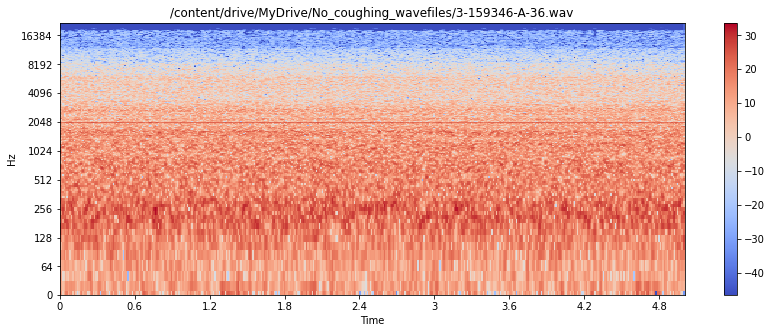

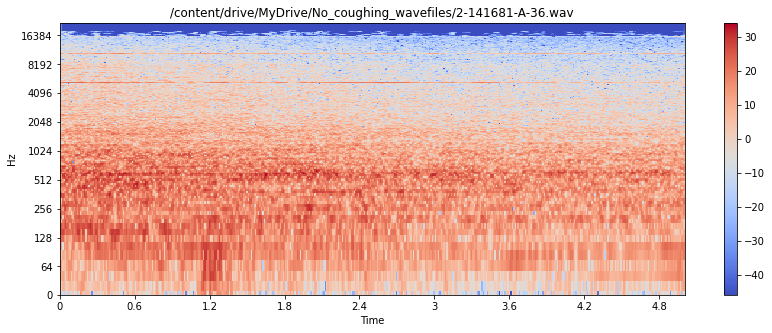

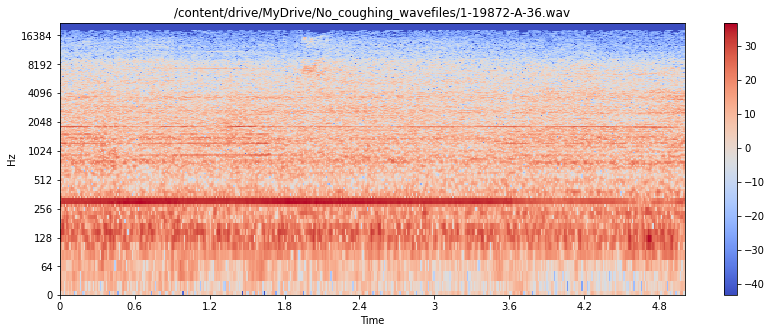

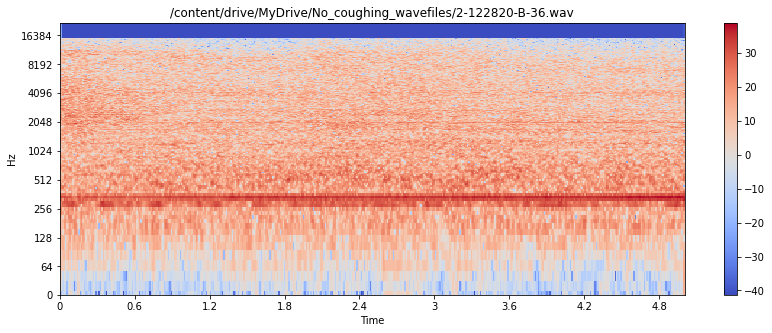

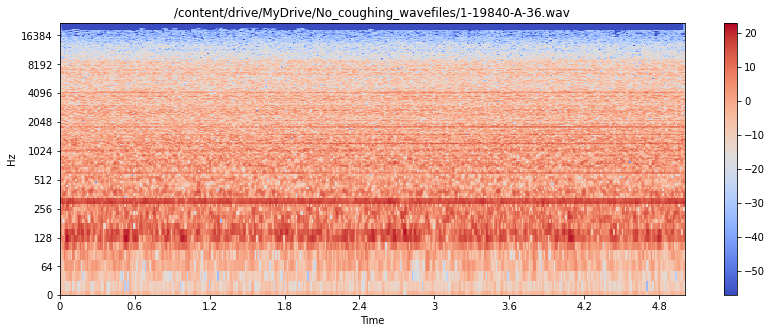

...

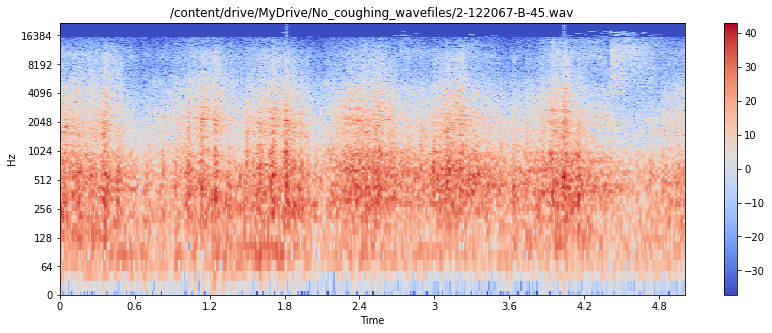

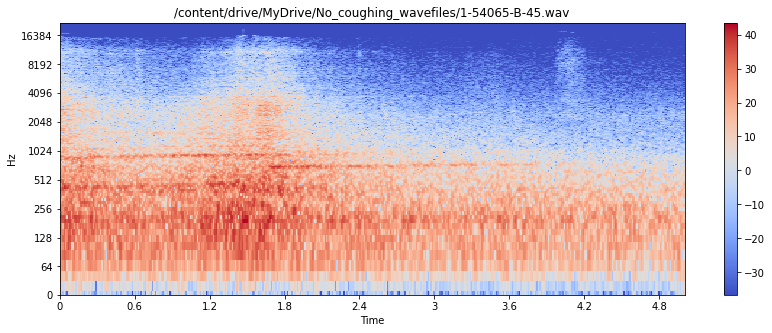

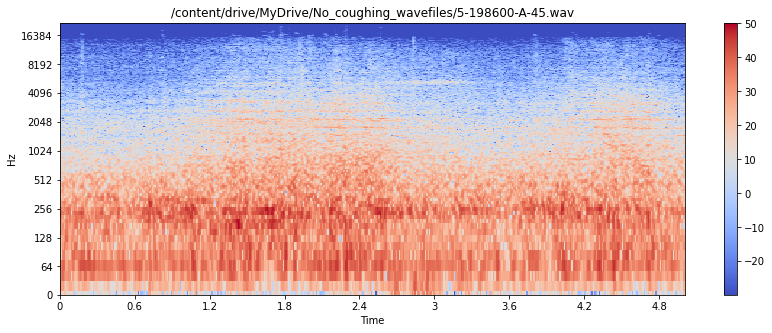

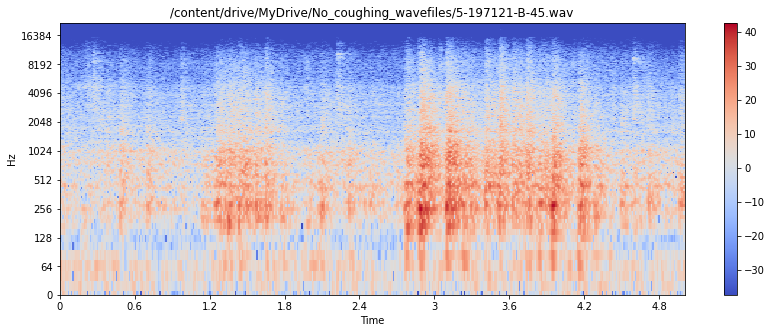

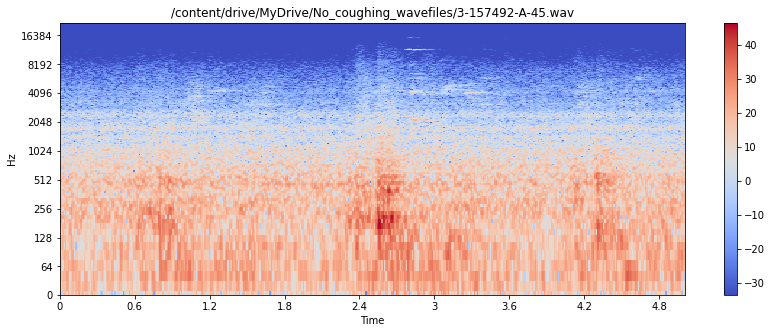

In [93]:
for row in (No_coughing_wavefiles):
    file_name1 = os.path.join(os.path.abspath(row))
    viz=convert_audio_to_spectogram_log(file_name1)

##Teachable machine model:

I have downloaded above spectrograms into separate folders: coughing class and no coughing class.

I took 40 spectrograms of coughing class and 40 spectrograms of no coughing (Train,Thunderstorm,Vacuumcleaner,Rooster) class. Divided train set and test set for each class.

*Train set:* 

coughing    = 30 spectrograms

No coughing = 10 spectrograms

*Test set:* 

coughing    = 30 spectrograms

No coughing = 10 spectrograms


Fetch the train set of coughing and no coughing class into teachable machine. I have attached screenshot for teachable machine prediction for a test sample of coughing and also for no coughing

For Epochs 50, batch size 32 and learning rate 0.001, I have trained the model on teachable machine.
Coughing test spectrogram was feeded to the teachable machine. Machine predicted with 98% accuracy. I have attached the screenshot.

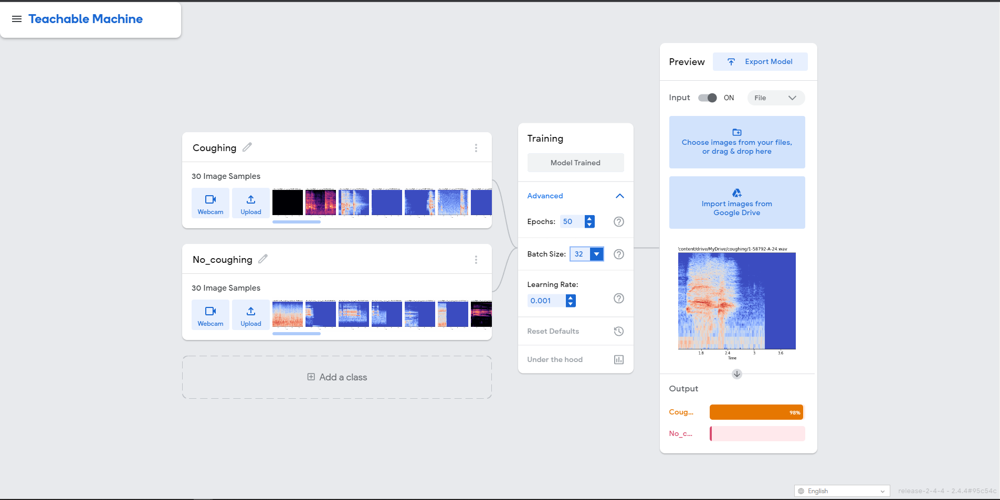

For Epochs 50, batch size 16 and learning rate 0.001, I have trained the model on teachable machine. No_coughing test spectrogram was feeded to the teachable machine. Machine predicted with 96% accuracy. I have attached the screenshot.

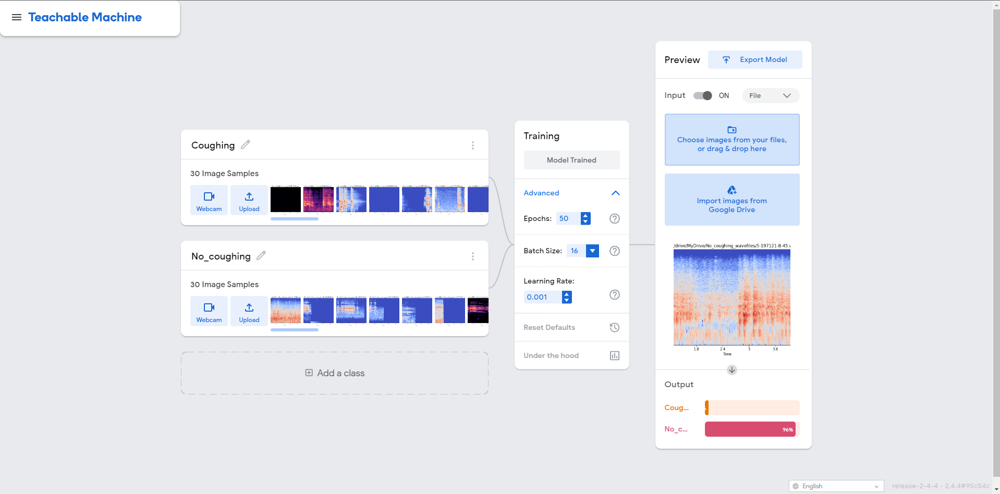

For Epochs 50, batch size 16 and learning rate 0.001, I have trained the model on teachable machine. Coughing test spectrogram was feeded to the teachable machine. Machine predicted with 100% accuracy. I have attached the screenshot.

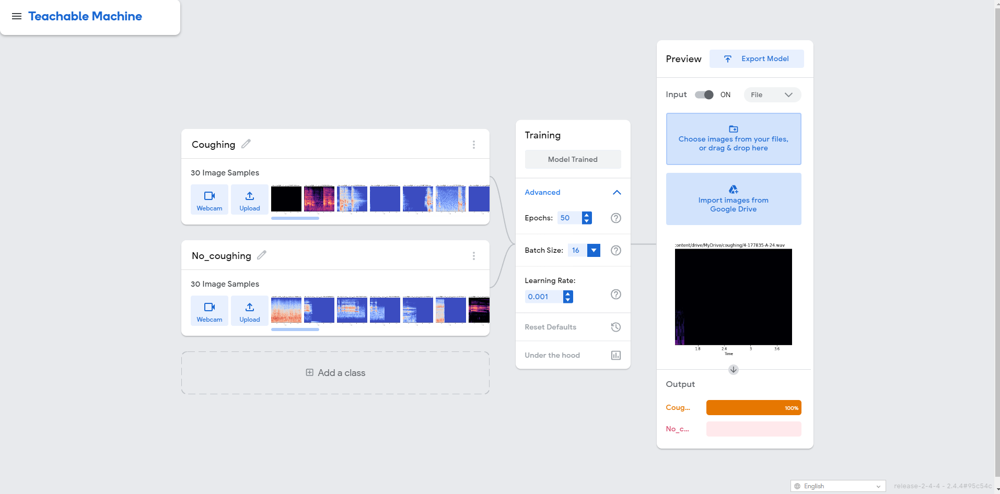

The following model is exported from teachable machine. Attaching the code and also screenshot of teachable machine code

In [ ]:
from keras.models import load_model
from PIL import Image, ImageOps
import numpy as np

# Load the model
model = load_model('keras_model.h5')

# Create the array of the right shape to feed into the keras model
# The 'length' or number of images you can put into the array is
# determined by the first position in the shape tuple, in this case 1.
data = np.ndarray(shape=(1, 224, 224, 3), dtype=np.float32)
# Replace this with the path to your image
image = Image.open('<IMAGE_PATH>')
#resize the image to a 224x224 with the same strategy as in TM2:
#resizing the image to be at least 224x224 and then cropping from the center
size = (224, 224)
image = ImageOps.fit(image, size, Image.ANTIALIAS)

#turn the image into a numpy array
image_array = np.asarray(image)
# Normalize the image
normalized_image_array = (image_array.astype(np.float32) / 127.0) - 1
# Load the image into the array
data[0] = normalized_image_array

# run the inference
prediction = model.predict(data)
print(prediction)


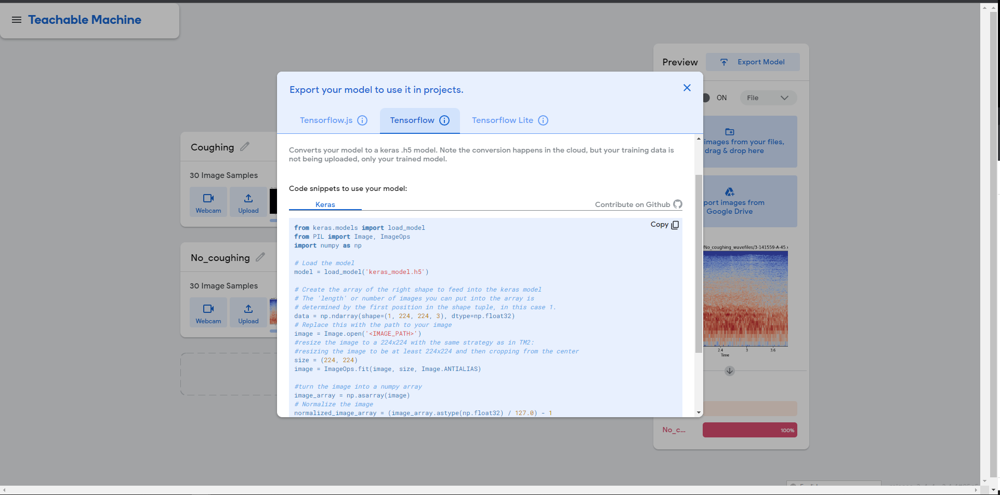

Teachable machine seems to be showing good accuracy for coughing and no coughing class